## Introduction

For this competition, you should generate images in the style of Monet. This generator is trained using a discriminator.

The two models will work against each other, with the generator trying to trick the discriminator, and the discriminator trying to accurately classify the real vs. generated images.

The dataset contains four directories: monet_tfrec, photo_tfrec, monet_jpg, and photo_jpg. The monet_tfrec and monet_jpg directories contain 300 painting images 256 x 256. The photo_tfrec and photo_jpg directories contain 7,028 photos of size 256 x 256. The monet directories contain Monet paintings, we'll use these to train the model. The photo directories contain photos which we will add Monet-style to.

The task is to build a GAN that generates 7,000 to 10,000 Monet-style images.

In [2]:
!pip install torchsummary

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import matplotlib.pyplot as plt
from pandas.core.common import flatten
import copy
import numpy as np
import random
import os

import PIL
import PIL.Image

import torch
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import Dataset, DataLoader
import torchvision.utils as vutils
from torchsummary import summary

import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
from mpl_toolkits.axes_grid1 import ImageGrid

import glob
from sklearn.model_selection import train_test_split
from tqdm import tqdm

In [5]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(False) # Needed for reproducible results

Random Seed:  999


In [6]:
# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [7]:
train_transforms = A.Compose(
    [
        A.SmallestMaxSize(max_size=350),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=360, p=0.5),
        A.RandomCrop(height=256, width=256),
        A.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.MultiplicativeNoise(multiplier=[0.5,2], per_channel=True, p=0.2),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.HueSaturationValue(hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5),
        A.RandomBrightnessContrast(brightness_limit=(-0.1,0.1), contrast_limit=(-0.1, 0.1), p=0.5),
        ToTensorV2(),
    ]
)

test_transforms = A.Compose(
    [
        A.SmallestMaxSize(max_size=350),
        A.CenterCrop(height=256, width=256),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

In [8]:
train_data_path = '/kaggle/input/gan-getting-started/monet_jpg' 
test_data_path = '/kaggle/input/gan-getting-started/photo_jpg'

In [9]:
jpg = []

# Assuming train_data_path is the directory containing the .tfrec files
for data_path in glob.glob(train_data_path + '/*.jpg'):
    jpg.append(data_path)


# Split the data into training and validation sets
train_paths, val_paths = train_test_split(jpg, test_size=0.2, random_state=42)

# Print the number of files in each set to verify
print(f"Number of training files: {len(train_paths)}")
print(f"Number of validation files: {len(val_paths)}")

Number of training files: 240
Number of validation files: 60


In [10]:
test_paths = []

# Assuming train_data_path is the directory containing the .tfrec files
for data_path in glob.glob(test_data_path + '/*.jpg'):
    test_paths.append(data_path)

# Print the number of files in each set to verify
print(f"Number of training files: {len(test_paths)}")

Number of training files: 7038


In [11]:
# function to display (or save) an image, either for the image in dataset or the generated fake image
def show_image(image, epoch=None, iteration=None, loss=None, save=False):
    plt.figure(figsize = (4, 4))
    
    # convert tensor to a numpy array for plot
    if isinstance(image, torch.Tensor):
        image = image.permute(1, 2, 0).detach().numpy()

    # rescale image from [-1, 1] to [0,1]
    if np.min(image) < 0:
        image = (image + 1) / 2

    plt.imshow(image)
    
    # save option
    if save and epoch is not None and iteration is not None and loss is not None:
        filename = f'generated_img_epoch_{epoch}_iteration_{iteration}_loss_{loss:.3f}.png'
        plt.savefig(filename)
        
    plt.show()

In [12]:
# function to display a batch, either in the dataset or the generated fake batch
def show_batch(images_list, epoch=None, iteration=None, loss=None, save=False):
    fig = plt.figure(figsize = (14, 14))
    # define how many image space will be displayed
    lenth = int(np.ceil(np.sqrt(len(images_list))))
    shape = (lenth, lenth)
    
    grid = ImageGrid(fig, 111, nrows_ncols = shape, axes_pad = 0.05)

    # convert tensor to a numpy array for plot
    if isinstance(images_list, torch.Tensor):
        images_list = images_list.permute(0, 2, 3, 1).detach().numpy()

    # rescale image from [-1, 1] to [0,1]
    if np.min(images_list) < 0:
        images_list = (images_list + 1) / 2
    
    # plot grids
    for ax, image in zip(grid, images_list):
        ax.imshow(image)

    # save option
    if save and epoch is not None and iteration is not None and loss is not None:
        filename = f'generated_batch_epoch_{epoch}_iteration_{iteration}_loss_{loss:.3f}.png'
        plt.savefig(filename)

    plt.show()

In [13]:
#######################################################
#               Define Dataset Class
#######################################################
class MonetDataset(Dataset):
    def __init__(self, image_paths, transform=False):
        self.image_paths = image_paths
        self.transform = transform
        
    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_filepath = self.image_paths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        if self.transform is not None:
            image = self.transform(image=image)["image"]
        
        return image

In [14]:
#######################################################
#                  Create Dataset
#######################################################

train_dataset = MonetDataset(train_paths, train_transforms)
valid_dataset = MonetDataset(val_paths, test_transforms) #test transforms are applied
test_dataset = MonetDataset(test_paths, test_transforms)

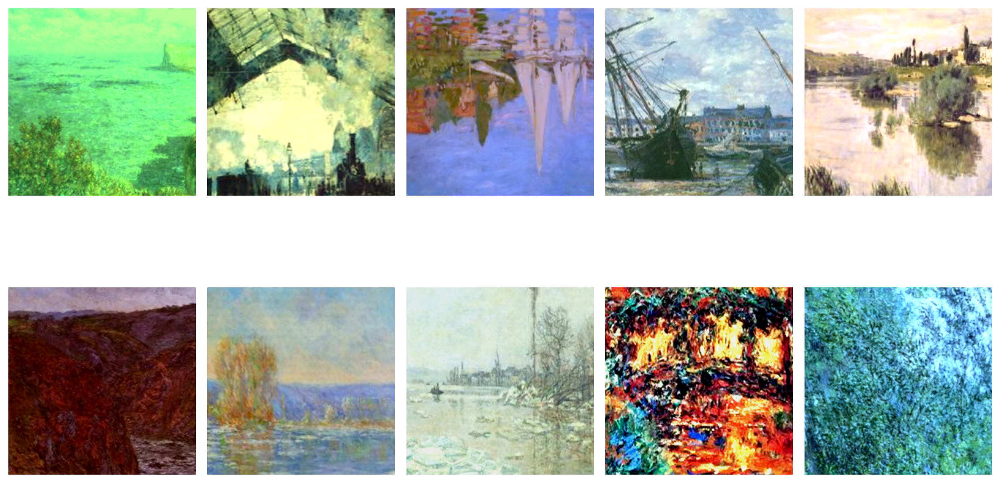

In [15]:
import matplotlib.pyplot as plt
%matplotlib inline

#######################################################
#                  Visualize Dataset
#         Images are plotted after augmentation
#######################################################
def visualize_augmentations(dataset, idx=0, samples=10, cols=5, random_img = False):
    
    dataset = copy.deepcopy(dataset)
    #we remove the normalize and tensor conversion from our augmentation pipeline
    dataset.transform = A.Compose([t for t in dataset.transform if not isinstance(t, (A.Normalize, ToTensorV2))])
    rows = samples // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(12, 8))
    for i in range(samples):
        if random_img:
            idx = np.random.randint(1, len(train_paths))
        image = dataset[idx]
        ax.ravel()[i].imshow(image)
        ax.ravel()[i].set_axis_off()
        
    plt.tight_layout(pad=1)
    plt.show()

visualize_augmentations(train_dataset, np.random.randint(1,len(train_paths)), random_img = True)

In the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0 and stdev=0.02.

The weights_init function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet these criteria.

This function is applied to the models immediately after initialization.

In [16]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## DCGAN

A DCGAN is a direct extension of the GAN, except that it explicitly uses convolutional and convolutional-transpose layers in the discriminator and generator, respectively. It was first described by Radford et. al. in the paper Unsupervised Representation Learning With Deep Convolutional Generative Adversarial Networks. The discriminator is made up of strided convolution layers, batch norm layers, and LeakyReLU activations. The input is a 3x64x64 input image and the output is a scalar probability that the input is from the real data distribution. The generator is comprised of convolutional-transpose layers, batch norm layers, and ReLU activations. The input is a latent vector, z.

z, that is drawn from a standard normal distribution and the output is a 3x64x64 RGB image. The strided conv-transpose layers allow the latent vector to be transformed into a volume with the same shape as an image.


In [18]:
class Generator(nn.Module):
    def __init__(self, noise_dim):
        super(Generator, self).__init__()

        self.model = nn.Sequential(
            # Fully connected layer
            nn.Linear(noise_dim, 8 * 8 * 512, bias=False),
            nn.BatchNorm1d(8 * 8 * 512),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Reshape to (512, 8, 8)
            nn.Unflatten(1, (512, 8, 8)),
            
            # Transposed Convolutional Layer 1
            nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Transposed Convolutional Layer 2
            nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Transposed Convolutional Layer 3
            nn.ConvTranspose2d(128, 64, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Transposed Convolutional Layer 4
            nn.ConvTranspose2d(64, 32, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),
            
            # Final Transposed Convolutional Layer
            nn.ConvTranspose2d(32, 3, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.Tanh()  # Tanh activation to match the output range [-1, 1]
        )
        
    def forward(self, x):
        # Flatten the noise input to match the expected input shape for the linear layer
        x = x.view(x.size(0), -1)
        return self.model(x)
        
class Discriminator(nn.Module):
    # constructor method
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
                # Convolutional Layer 1
                nn.Conv2d(
                    in_channels=3,   # Input channels (e.g., RGB image)
                    out_channels=32, # Output channels (number of filters)
                    kernel_size=3,   # Size of the convolution kernel
                    stride=2,        # Stride of the convolution
                    padding=1        # Padding to maintain the spatial dimensions
                ),
                nn.LeakyReLU(negative_slope=0.01), # LeakyReLU activation
                nn.Dropout(p=0.3),                 # Dropout layer with 30% probability
        
                # Convolutional Layer 2
                nn.Conv2d(
                    in_channels=32,
                    out_channels=64,
                    kernel_size=3,
                    stride=2,
                    padding=1
                ),
                nn.LeakyReLU(negative_slope=0.01),
                nn.Dropout(p=0.3),
        
                # Convolutional Layer 3
                nn.Conv2d(
                    in_channels=64,
                    out_channels=128,
                    kernel_size=3,
                    stride=2,
                    padding=1
                ),
                nn.LeakyReLU(negative_slope=0.01),
                nn.Dropout(p=0.3),
    
                # Convolutional Layer 4
                nn.Conv2d(
                    in_channels=128,
                    out_channels=256,
                    kernel_size=3,
                    stride=2,
                    padding=1
                ),
                nn.LeakyReLU(negative_slope=0.01),
                nn.Dropout(p=0.3),
                
                nn.Flatten(),                          # Flatten layer
                nn.Linear(256 * 16 * 16, 1),          # Fully connected layer (adjust input size based on your architecture)
                nn.Sigmoid()                          # Sigmoid activation
            )
        
    # forward method
    def forward(self, input):
        x = self.model(input)
        return x


In [19]:
# initialize the discriminator and move the params to gpu
discriminator = Discriminator().to(device)
# summary the disciminator
summary(discriminator, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             896
         LeakyReLU-2         [-1, 32, 128, 128]               0
           Dropout-3         [-1, 32, 128, 128]               0
            Conv2d-4           [-1, 64, 64, 64]          18,496
         LeakyReLU-5           [-1, 64, 64, 64]               0
           Dropout-6           [-1, 64, 64, 64]               0
            Conv2d-7          [-1, 128, 32, 32]          73,856
         LeakyReLU-8          [-1, 128, 32, 32]               0
           Dropout-9          [-1, 128, 32, 32]               0
           Conv2d-10          [-1, 256, 16, 16]         295,168
        LeakyReLU-11          [-1, 256, 16, 16]               0
          Dropout-12          [-1, 256, 16, 16]               0
          Flatten-13                [-1, 65536]               0
           Linear-14                   

In [20]:
disc = Discriminator()

# Test with real images
real_images = torch.randn(32, 3, 256, 256)  # Batch of 16 random images
output = disc(real_images)
print(output.shape)  # Should be [16, 1]

torch.Size([32, 1])


In [21]:
# define the dimension of the noise
noise_dim = 128
# initialize the generator and move the params to gpu
generator = Generator(noise_dim).to(device)
# summary the generator
summary(generator, (noise_dim, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                [-1, 32768]       4,194,304
       BatchNorm1d-2                [-1, 32768]          65,536
         LeakyReLU-3                [-1, 32768]               0
         Unflatten-4            [-1, 512, 8, 8]               0
   ConvTranspose2d-5          [-1, 256, 16, 16]       3,276,800
       BatchNorm2d-6          [-1, 256, 16, 16]             512
         LeakyReLU-7          [-1, 256, 16, 16]               0
   ConvTranspose2d-8          [-1, 128, 32, 32]         819,200
       BatchNorm2d-9          [-1, 128, 32, 32]             256
        LeakyReLU-10          [-1, 128, 32, 32]               0
  ConvTranspose2d-11           [-1, 64, 64, 64]         204,800
      BatchNorm2d-12           [-1, 64, 64, 64]             128
        LeakyReLU-13           [-1, 64, 64, 64]               0
  ConvTranspose2d-14         [-1, 32, 1

In [22]:
# set Binary Cross Entropy as loss function
criterion = nn.BCELoss()
# learning rate
lr = 0.0001
# important param in Adam to tune
beta1 = 0.5

# define optimizers for G and D
optimizerD = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))

In [24]:
#######################################################
#                  Create Dataloaders
#######################################################

# Create DataLoaders
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
valid_dataloader = DataLoader(valid_dataset, batch_size=32, shuffle=False, num_workers=4)
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

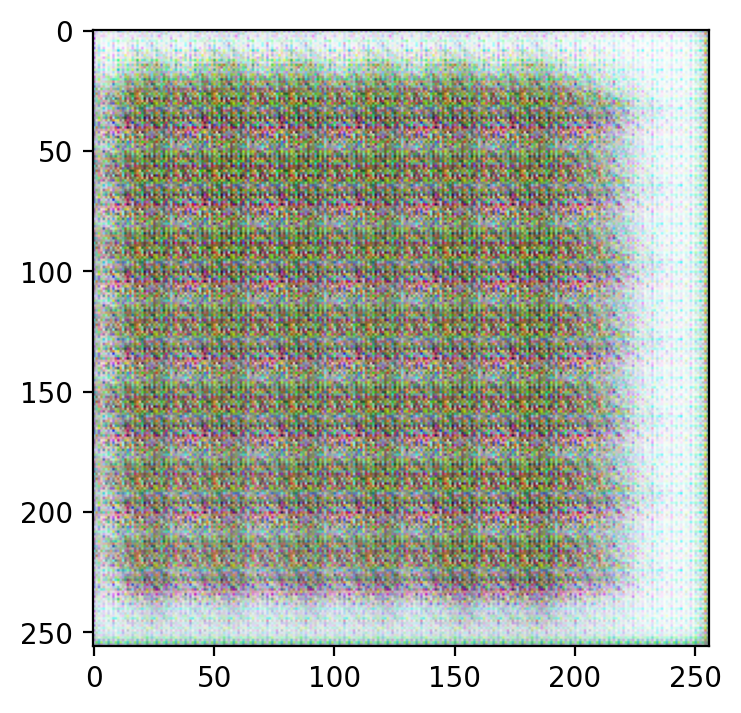

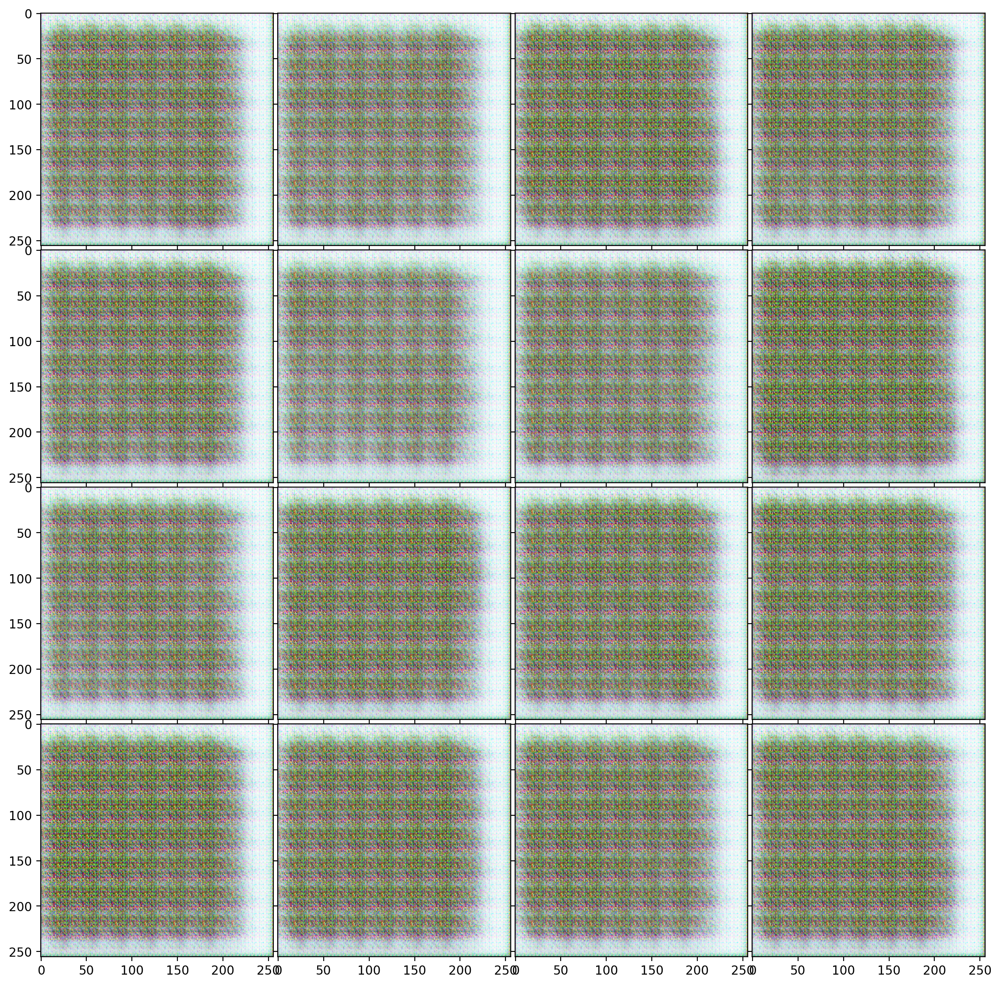

In [25]:
import torch
import torch.nn as nn
import torch.optim as optim

# Assuming the models are already defined: generator, discriminator
# Assuming the optimizers are defined: optimizerG, optimizerD
# Assuming the criterion is defined: criterion (e.g., nn.BCEWithLogitsLoss())

num_epochs = 100
real_label = 1.
fake_label = 0.
G_losses = []
D_losses = []
lowest_loss = float('inf')
best_fake = None
results = []

for epoch in range(num_epochs):
    for i, data in enumerate(train_dataloader, 0):
        # Get real data
        real_data = data.to(device)
        batch_size = real_data.size(0)
        
        # Initialize Discriminator gradients
        discriminator.zero_grad()
        
        # Real label tensor
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
        
        # Discriminator on real data
        output = discriminator(real_data).view(-1)
        D_real_loss = criterion(output, label)
        D_real_loss.backward()
        
        # Generate fake data
        noise = torch.randn(batch_size, noise_dim, 1, 1, device=device)
        fake = generator(noise)
        
        # Fake label tensor
        label.fill_(fake_label)
        
        # Discriminator on fake data
        output = discriminator(fake.detach()).view(-1)
        D_fake_loss = criterion(output, label)
        D_fake_loss.backward()
        
        # Update Discriminator
        D_loss = D_real_loss + D_fake_loss
        D_losses.append(D_loss.item())
        optimizerD.step()
        
        # Initialize Generator gradients
        generator.zero_grad()
        
        # Generator loss
        label.fill_(real_label)  # We want the Discriminator to think the fake images are real
        output = discriminator(fake).view(-1)
        G_loss = criterion(output, label)
        G_losses.append(G_loss.item())
        G_loss.backward()
        
        # Update Generator
        optimizerG.step()
        
        # Save the best fake images
        current_loss = G_losses[-1]
        if current_loss < lowest_loss:
            lowest_loss = current_loss
            best_fake = fake.detach().cpu()
        
        # Save loss information
        results.append({
            'Epoch': epoch,
            'Batch': i,
            'Loss_D': D_loss.item(),
            'Loss_G': G_loss.item()
        })

    # Save or display images
if best_fake is not None:
    show_image(best_fake[0], epoch, i, loss=lowest_loss, save=False)  
    show_batch(best_fake, epoch, i, loss=lowest_loss, save=False)

*Seems* I unable to feed a set of images in DCGAN, I will create a CycleGAN now instead

# CycleGAN

CycleGAN, or Cycle-Consistent GAN, is a type of generative adversarial network for unpaired image-to-image translation. The novelty lies in trying to enforce the intuition that these mappings should be reverses of each other and that both mappings should be bijections. This is achieved through a cycle consistency loss that encourages and. Combining this loss with the adversarial losses on  and yields the full objective for unpaired image-to-image translation.

In [26]:
import torch.nn as nn
import torch.nn.functional as F

class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        conv_block = [  nn.ReflectionPad2d(1),
                        nn.Conv2d(in_features, in_features, 3),
                        nn.InstanceNorm2d(in_features),
                        nn.ReLU(inplace=True),
                        nn.ReflectionPad2d(1),
                        nn.Conv2d(in_features, in_features, 3),
                        nn.InstanceNorm2d(in_features)  ]

        self.conv_block = nn.Sequential(*conv_block)

    def forward(self, x):
        return x + self.conv_block(x)

class Generator(nn.Module):
    def __init__(self, input_nc, output_nc, n_residual_blocks=9):
        super(Generator, self).__init__()

        # Initial convolution block       
        model = [   nn.ReflectionPad2d(3),
                    nn.Conv2d(input_nc, 64, 7),
                    nn.InstanceNorm2d(64),
                    nn.ReLU(inplace=True) ]

        # Downsampling
        in_features = 64
        out_features = in_features*2
        for _ in range(2):
            model += [  nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                        nn.InstanceNorm2d(out_features),
                        nn.ReLU(inplace=True) ]
            in_features = out_features
            out_features = in_features*2

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResidualBlock(in_features)]

        # Upsampling
        out_features = in_features//2
        for _ in range(2):
            model += [  nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                        nn.InstanceNorm2d(out_features),
                        nn.ReLU(inplace=True) ]
            in_features = out_features
            out_features = in_features//2

        # Output layer
        model += [  nn.ReflectionPad2d(3),
                    nn.Conv2d(64, output_nc, 7),
                    nn.Tanh() ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_nc):
        super(Discriminator, self).__init__()

        # A bunch of convolutions one after another
        model = [   nn.Conv2d(input_nc, 64, 4, stride=2, padding=1),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(64, 128, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(128), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(128, 256, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(256), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(256, 512, 4, padding=1),
                    nn.InstanceNorm2d(512), 
                    nn.LeakyReLU(0.2, inplace=True) ]

        # FCN classification layer
        model += [nn.Conv2d(512, 1, 4, padding=1)]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        x =  self.model(x)
        # Average pooling and flatten
        return F.avg_pool2d(x, x.size()[2:]).view(x.size()[0], -1)

In [27]:
import torch.optim as optim

# Initialize the models
generator = Generator(input_nc=3, output_nc=3).to(device)  # Assuming RGB images
discriminator = Discriminator(input_nc=3).to(device)

# Loss function
criterion = nn.BCELoss()

num_epochs = 100
real_label = 1.
fake_label = 0.
G_losses = []
D_losses = []
lowest_loss = float('inf')
best_fake = None
results = []


# Optimizers
lr = 0.0002
beta1 = 0.5  # A common setting for Adam in GANs
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))

In [28]:
for epoch in range(num_epochs):
    for i, imgs in enumerate(train_dataloader):
        
        # Configure input
        real_imgs = imgs.to(device)  # Move input images to the same device as the models
        batch_size = real_imgs.size(0)

        # Create labels on the correct device
        real_labels = torch.ones(batch_size, 1).to(device)
        fake_labels = torch.zeros(batch_size, 1).to(device)

        ## --- Train Discriminator ---
        optimizer_D.zero_grad()

        # Real images
        real_outputs = torch.sigmoid(discriminator(real_imgs))
        d_loss_real = criterion(real_outputs, real_labels)

        # Fake images
        z = torch.randn(batch_size, 3, 256, 256).to(device)  # Random noise for generator
        fake_imgs = generator(z)
        fake_outputs = torch.sigmoid(discriminator(fake_imgs.detach()))
        d_loss_fake = criterion(fake_outputs, fake_labels)

        # Total discriminator loss and backward pass
        d_loss = (d_loss_real + d_loss_fake) * 0.5
        d_loss.backward()
        optimizer_D.step()

        ## --- Train Generator ---
        optimizer_G.zero_grad()

        # Generate fake images and classify them as real
        fake_outputs = torch.sigmoid(discriminator(fake_imgs))
        g_loss = criterion(fake_outputs, real_labels)

        # Generator backward pass
        g_loss.backward()
        optimizer_G.step()

        # Print the progress
        print(f"Epoch [{epoch}/{num_epochs}] Batch {i}/{len(train_dataloader)} "
              f"Loss D: {d_loss.item()}, Loss G: {g_loss.item()}")

Epoch [0/100] Batch 0/8 Loss D: 0.6952868700027466, Loss G: 0.9341491460800171
Epoch [0/100] Batch 1/8 Loss D: 0.6705353260040283, Loss G: 0.7708368897438049
Epoch [0/100] Batch 2/8 Loss D: 0.6524111032485962, Loss G: 0.7460339069366455
Epoch [0/100] Batch 3/8 Loss D: 0.6737140417098999, Loss G: 0.930401623249054
Epoch [0/100] Batch 4/8 Loss D: 0.6806986331939697, Loss G: 0.9688642024993896
Epoch [0/100] Batch 5/8 Loss D: 0.6347319483757019, Loss G: 0.9762011766433716
Epoch [0/100] Batch 6/8 Loss D: 0.5904589891433716, Loss G: 0.9921836853027344
Epoch [0/100] Batch 7/8 Loss D: 0.6099505424499512, Loss G: 1.0073461532592773
Epoch [1/100] Batch 0/8 Loss D: 0.6338497400283813, Loss G: 0.9841656684875488
Epoch [1/100] Batch 1/8 Loss D: 0.6540360450744629, Loss G: 0.8675216436386108
Epoch [1/100] Batch 2/8 Loss D: 0.6804773211479187, Loss G: 0.9264596700668335
Epoch [1/100] Batch 3/8 Loss D: 0.6325610876083374, Loss G: 0.8619264960289001
Epoch [1/100] Batch 4/8 Loss D: 0.6324917078018188, L

In [ ]:
import torch
import torchvision.utils as vutils
import io
import zipfile

# Make sure your model is in evaluation mode
generator.eval()

# Initialize an in-memory zip file
zip_buffer = io.BytesIO()

# Create a zip file in memory and add images to it
with zipfile.ZipFile(zip_buffer, 'w', zipfile.ZIP_DEFLATED) as zipf:
    # Iterate over all batches in the test_dataloader
    for batch_idx, real_imgs in enumerate(test_dataloader):  # Assuming the dataset returns (data, labels); ignore labels
        real_imgs = real_imgs.to(device)  # Move the images to the correct device
        
        # Generate images from the real input using the generator
        with torch.no_grad():  # Disable gradient calculation during testing
            generated_imgs = generator(real_imgs)  # Pass real images through the generator
        
        # For each image in the batch, save it to the zip file
        for i in range(generated_imgs.size(0)):
            # Convert the generated image tensor to a byte stream
            image_buffer = io.BytesIO()
            vutils.save_image(generated_imgs[i], image_buffer, format='png')
            
            # Add the image to the zip file with a unique name
            zipf.writestr(f'image_{batch_idx * test_dataloader.batch_size + i}.png', image_buffer.getvalue())
            
            # Reset the buffer for the next image
            image_buffer.close()

# Save the in-memory zip to a file on disk
zip_file_path = '/kaggle/working/images.zip'
with open(zip_file_path, 'wb') as f:
    f.write(zip_buffer.getvalue())

print(f'Saved all generated images to {zip_file_path} as a zip file.')

* # Conclusion

Seems like the model is repeating the pictures inside the frame, I think it's due to the kernel size and convulation layers. 

Possible fixes are:

1. Fix the convulation layers so that the picture is taken as a whole
2. Fix the kernel sizes to encapsulate the whole image.